

#**Robust yield prediction of various farm processing units**








##Problem Description: 
A new fast food chain is seeing rapid expansion over the past couple of years. They 
are now trying to optimize their supply chain to ensure that there are no shortages 
of  ingredients.  For this, they’ve tasked their data science team to come up with a 
model that could predict the output of each food processing farm over the next 
few years. These predictions could further increase the efficiency of their current 
supply chain management systems. 

###About Data: 
The datasets are named as follows: 
 
● **‘train_data.csv’:** 

○ date: ​ The timestamp at which the yield of the food processing farm 
was measured 

○ farm_id: ​ The farm identifier that recognizes the farm food processing 
plant 

○ ingredient_type: ​ The type of ingredient being produced 

○ yield: ​ The yield of the plant in tonnes 
 
● **‘farm_data.csv’:** 

○ farm_id: ​ The farm identifier that recognizes the farm food processing 
plant 

○ founding_year: ​ They year when the operations commenced on the 
farm and food processing plant.  

○ num_processing_plants: ​ The number of processing plants present 
on the farm 

○ farm_area: ​ The area of the farm in square meters 

○ farming_company: ​ The company that owns the farms 

○ deidentified_location: ​ The location at which the farm is present 
 
● **‘train_weather.csv’:**

○ For each location where the farms are present, the weather data is also 
provided by timestamp 
 

##Goal to study each of train_data,weather_data and farm_data and do the necessary pre-processing 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
import pandas as pd
import numpy as np
import altair as alt
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [0]:
farm_data_master=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/farm_data.csv')
train_data_master=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/train_data.csv')
train_weather_master=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/train_weather.csv')

In [6]:
farm_data_master

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
0,fid_110884,2008.0,NaN,690.455096,Obery Farms,location 7369
1,fid_90053,2004.0,NaN,252.696160,Obery Farms,location 7369
2,fid_17537,1991.0,NaN,499.446528,Obery Farms,location 7369
3,fid_110392,2002.0,NaN,2200.407555,Obery Farms,location 7369
4,fid_62402,1975.0,NaN,10833.140121,Obery Farms,location 7369
...,...,...,...,...,...,...
1444,fid_41664,1914.0,NaN,1822.663957,Sanderson Farms,location 5150
1445,fid_14529,NaN,NaN,399.297094,Obery Farms,location 5150
1446,fid_46454,1997.0,NaN,1046.552295,Sanderson Farms,location 5150
1447,fid_24103,2001.0,NaN,2766.186825,Dole Food Company,location 5150


In [7]:
farm_data_master.describe()
## Count will give the vaules that are present so remaining values will be null. 

,operations_commencing_year,num_processing_plants,farm_area
count,675.000000,355.000000,1449.000000
mean,1967.957037,7.740845,8557.460363
std,31.054030,3.333683,10290.860757
min,1900.000000,5.000000,26.291549
25%,1949.000000,5.000000,2137.883836
50%,1970.000000,7.000000,5357.994719
75%,1995.000000,9.000000,10746.647428
max,2017.000000,30.000000,81290.125000


In [8]:
farm_data_master.operations_commencing_year.isna().value_counts()

True     774
False    675
Name: operations_commencing_year, dtype: int64

In [9]:
farm_data_master.num_processing_plants.isna().value_counts()

True     1094
False     355
Name: num_processing_plants, dtype: int64

In [10]:
farm_data_master.farming_company.unique().size

16

In [11]:
train_data_master.farm_id.unique().size

1434

In [14]:
farm_data_master.farming_company.value_counts().index.values

array(['Obery Farms', 'Wayne Farms', 'Sanderson Farms', 'Del Monte Foods',
       'Dole Food Company', 'Other', 'Foster Farms', 'Freight Farms',
       'Mountaire Farms', 'Monogram Foods', 'Tyson Foods',
       'Northland Organic Foods Corporation', 'West Liberty Foods',
       'Perdue Farms', 'Kansas Ville Farms', 'Southern Confederate Farms'],
      dtype=object)

In [51]:
pd.options.display.float_format = '{:.2f}'.format
farm_data_master[['farming_company','farm_area']].groupby(by="farming_company",as_index=False).sum()

,farming_company,farm_area
0,Del Monte Foods,941272.39
1,Dole Food Company,1165856.93
2,Foster Farms,300175.17
3,Freight Farms,570937.15
4,Kansas Ville Farms,11555.55
5,Monogram Foods,45842.99
6,Mountaire Farms,55053.85
7,Northland Organic Foods Corporation,186418.32
8,Obery Farms,5321169.92
9,Other,73060.22


##### So 1449 rows are present in farm data which means there are duplicates  by farm_id which should be unique.Current goal to elilinate the dupicate or to find why the duplicates exsits.


In [52]:
# Duplicate farm_ids
1449-1434 

15

In [54]:
repeated_farms_in_farm_data=list(np.array(farm_data_master.groupby(by="farm_id",as_index=False)["farm_area"].count()[farm_data_master.groupby(by="farm_id",as_index=False)["farm_area"].count()["farm_area"]>1]["farm_id"]))
repeated_farms_in_farm_data

['fid_122174',
 'fid_18990',
 'fid_26064',
 'fid_29387',
 'fid_40459',
 'fid_53126',
 'fid_54932',
 'fid_59158',
 'fid_63700',
 'fid_68761',
 'fid_68792',
 'fid_71910',
 'fid_73431',
 'fid_81333',
 'fid_97094']

In [55]:
farm_data_master[farm_data_master.farm_id.isin(repeated_farms_in_farm_data)==True].sort_values("farm_id")

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
1136,fid_122174,nan,nan,7411.99,Wayne Farms,location 2532
1076,fid_122174,nan,nan,10874.67,Dole Food Company,location 2532
594,fid_18990,1964.00,11.00,16469.94,Obery Farms,location 5833
537,fid_18990,1959.00,nan,6800.50,Obery Farms,location 5290
1156,fid_26064,nan,nan,24153.76,Obery Farms,location 2532
510,fid_26064,nan,nan,425.59,Del Monte Foods,location 5290
1043,fid_29387,nan,nan,2590.97,Wayne Farms,location 7048
634,fid_29387,1910.00,8.00,371.61,Obery Farms,location 5833
66,fid_40459,1981.00,nan,3459.80,Dole Food Company,location 7369
705,fid_40459,1976.00,5.00,2192.98,Obery Farms,location 6364


In [56]:
new_farm_data_master=farm_data_master.copy()
new_farm_data_master.drop([1076,537,510,634,705,574,360,678,1300,178,822,679,287,325,395],axis=0,inplace=True)
new_farm_data_master.reset_index(drop=True)

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
0,fid_110884,2008.00,nan,690.46,Obery Farms,location 7369
1,fid_90053,2004.00,nan,252.70,Obery Farms,location 7369
2,fid_17537,1991.00,nan,499.45,Obery Farms,location 7369
3,fid_110392,2002.00,nan,2200.41,Obery Farms,location 7369
4,fid_62402,1975.00,nan,10833.14,Obery Farms,location 7369
...,...,...,...,...,...,...
1429,fid_41664,1914.00,nan,1822.66,Sanderson Farms,location 5150
1430,fid_14529,nan,nan,399.30,Obery Farms,location 5150
1431,fid_46454,1997.00,nan,1046.55,Sanderson Farms,location 5150
1432,fid_24103,2001.00,nan,2766.19,Dole Food Company,location 5150


In [0]:
new_farm_data_master.to_csv('/content/drive/My Drive/Sudheer Projects/phd/new_farm_data.csv')

In [49]:
import altair as alt

source = pd.DataFrame({
    'Farming_company': farm_data_master.farming_company.value_counts().index.values,
    'Processing-plants Counts': farm_data_master.farming_company.value_counts().values
})

bars=alt.Chart(source).mark_bar().encode(
    x=alt.X('Processing-plants Counts:Q'),
    y=alt.Y('Farming_company:O',sort="x")

)

text = bars.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='Processing-plants Counts:Q'
)

source1 = pd.DataFrame({
    'Farming_company': farm_data_master.groupby(by=['farming_company']).sum().index.values,
    'Net Farm Area': farm_data_master.groupby(by=['farming_company']).sum()['farm_area'].values
})

bars1=alt.Chart(source1).mark_bar().encode(
    x=alt.X('Net Farm Area:Q'),
    y=alt.Y('Farming_company:O',sort="x")

)

text1 = bars1.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='Net Farm Area:Q'
)

import altair as alt

source2= pd.DataFrame({
    'deidentified_location': farm_data_master.deidentified_location.value_counts().index.values,
    'Processing-plants Counts': farm_data_master.deidentified_location.value_counts().values
})

bars2=alt.Chart(source2).mark_bar().encode(
    x=alt.X('Processing-plants Counts:Q'),
    y=alt.Y('deidentified_location:O',sort="x")

)

text2= bars2.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='Processing-plants Counts:Q'
)

source3 = pd.DataFrame({
    'deidentified_location': farm_data_master.groupby(by=['deidentified_location']).sum().index.values,
    'Net Farm Area': farm_data_master.groupby(by=['deidentified_location']).sum()['farm_area'].values
})

bars3=alt.Chart(source3).mark_bar().encode(
    x=alt.X('Net Farm Area:Q'),
    y=alt.Y('deidentified_location:O',sort="x")

)

text3 = bars3.mark_text(
    align='left',
    baseline='middle',
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='Net Farm Area:Q'
)

((bars + text).properties(height=400,width=450) | (bars1 + text1).properties(height=400,width=450)) & ((bars2 + text2).properties(height=400,width=450) | (bars3 + text3).properties(height=400,width=450))

alt.VConcatChart(...)

In [80]:
alt.Chart(new_farm_data_master[new_farm_data_master.operations_commencing_year.isna()==False]).mark_circle().encode(
    x='operations_commencing_year:O',
    y='farm_area:Q',
    color='farming_company:N',
    tooltip=['farm_id', 'operations_commencing_year', 'farm_area', 'farming_company','deidentified_location']
)

alt.Chart(...)

In [82]:
alt.Chart(new_farm_data_master[new_farm_data_master.num_processing_plants.isna()==False]).mark_circle().encode(
    x='num_processing_plants:O',
    y='farm_area:Q',
    color='farming_company:N',
    tooltip=['farm_id', 'num_processing_plants', 'farm_area', 'farming_company','deidentified_location']
)

alt.Chart(...)

In [0]:
new_farm_data_master=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/new_farm_data.csv',index_col=0)

In [7]:
train_weather_master.describe()

,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
count,139718.000000,70600.000000,133505.000000,139660.000000,129155.000000,89484.000000,139469.000000
mean,14.418106,2.149306,180.526632,7.350158,1016.158038,0.983047,3.560527
std,10.626595,2.599150,111.523629,9.790235,7.629684,8.463678,2.335874
min,-28.900000,0.000000,0.000000,-35.000000,968.200000,-1.000000,0.000000
25%,7.200000,0.000000,80.000000,0.600000,1011.800000,0.000000,2.100000
50%,15.000000,2.000000,190.000000,8.300000,1016.400000,0.000000,3.100000
75%,22.200000,4.000000,280.000000,14.400000,1020.800000,0.000000,5.000000
max,47.200000,9.000000,360.000000,26.100000,1045.500000,343.000000,19.000000


In [8]:
train_weather_master.deidentified_location.unique()

array(['location 7369', 'location 959', 'location 5489', 'location 5290',
       'location 5833', 'location 6364', 'location 565', 'location 4525',
       'location 5677', 'location 8421', 'location 1784', 'location 868',
       'location 7048', 'location 2532', 'location 5410', 'location 5150'],
      dtype=object)

In [9]:
new_farm_data_master.deidentified_location.unique()

array(['location 7369', 'location 959', 'location 5489', 'location 5290',
       'location 5833', 'location 6364', 'location 565', 'location 4525',
       'location 5677', 'location 8421', 'location 1784', 'location 868',
       'location 7048', 'location 2532', 'location 5410', 'location 5150'],
      dtype=object)

In [0]:
# Searching if there are any locations not present in farming data or  weather data
for location  in train_weather_master.deidentified_location.unique():
  if location in list(new_farm_data_master.deidentified_location.unique()):
    continue
  else:
    print(location)

In [18]:
#this showed me that there are some missing timestamps for weather recording
train_weather_master.deidentified_location.value_counts()

location 7369    8784
location 5677    8784
location 5489    8783
location 5833    8783
location 2532    8783
location 1784    8782
location 565     8782
location 8421    8780
location 5290    8780
location 5410    8777
location 959     8763
location 7048    8755
location 6364    8755
location 868     8614
location 4525    8614
location 5150    8454
Name: deidentified_location, dtype: int64

In [19]:
366*16*24

140544

###We should be having the weather data for all the 16 deidentifed locations for all the 366 dyas and 24 hours so we should be having 366 * 24 *16= 140544 rows which means we are having complete missing rows.

##### Since if we search and imput those missing rows in the dataframe it would be diffict since we need to find those missing rows or the timestamp at which the recording is missing and then add those timestamps with null values to the original dataset will be difficult.So the best solution is to aritfically create a new dataset with full timestamps for 366  * 24 hours across 16 locations and then do an outer join as to get the full perfect data. The biggest question as to why we are adding those row as we are thinking it to be a timeseries problem 

In [0]:
# We are creating an temperory dataframe 366*24 rows of timestamps across 16 locations and then we merge it with train_weather_master
temp_location_list=[]
temp_timestamp_list=[]
for i in train_weather_master.deidentified_location.unique():
    for j in pd.date_range('2016-01-01 00:00:00', periods=8784, freq='H'):
        temp_timestamp_list.append(j)
        temp_location_list.append(i)

new_train_weather_master=pd.DataFrame(columns=['timestamp', 'deidentified_location'])
new_train_weather_master.timestamp=pd.Series(temp_timestamp_list)
new_train_weather_master.deidentified_location=pd.Series(temp_location_list)

In [0]:
#changing the timestamp dtype so we can have one to one mapping for merging
train_weather_master.timestamp=train_weather_master.timestamp.astype('datetime64[ns]')

In [0]:
# merging it and sorting my new weather data
weather_merge=pd.merge(train_weather_master, new_train_weather_master, on=['timestamp', 'deidentified_location'], how='outer')
weather_merge=weather_merge.sort_values(by=['deidentified_location','timestamp']).reset_index(drop=True)

In [0]:
weather_merge.to_csv('/content/drive/My Drive/Sudheer Projects/phd/Train_weather_final.csv',index=False)

In [23]:
#notice weather there are full number of rows as 366*24 =8784 for each location
weather_merge.deidentified_location.value_counts()

location 8421    8784
location 5489    8784
location 868     8784
location 5833    8784
location 7048    8784
location 4525    8784
location 1784    8784
location 7369    8784
location 5410    8784
location 5677    8784
location 959     8784
location 5150    8784
location 2532    8784
location 6364    8784
location 565     8784
location 5290    8784
Name: deidentified_location, dtype: int64

In [29]:
weather_merge.dtypes

timestamp                datetime64[ns]
deidentified_location            object
temp_obs                        float64
cloudiness                      float64
wind_direction                  float64
dew_temp                        float64
pressure_sea_level              float64
precipitation                   float64
wind_speed                      float64
dtype: object

In [0]:
weather_merge=pd.read_csv("/content/drive/My Drive/Sudheer Projects/phd/Train_weather_final.csv",index_col=0)

In [63]:
alt.Chart(weather_merge[weather_merge.deidentified_location=='location 1784']).mark_line().encode(
    x='yearmonthdatehours(timestamp):T',
    y='temp_obs:Q'
).properties(height=400,width=450)

alt.Chart(...)

In [20]:
import altair as alt
alt.Chart(weather_merge[weather_merge.deidentified_location=='location 5150']).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('temp_obs:Q', title='temperature (F)')
)

alt.Chart(...)

In [8]:
weather_merge.deidentified_location.unique()

array(['location 1784', 'location 2532', 'location 4525', 'location 5150',
       'location 5290', 'location 5410', 'location 5489', 'location 565',
       'location 5677', 'location 5833', 'location 6364', 'location 7048',
       'location 7369', 'location 8421', 'location 868', 'location 959'],
      dtype=object)

In [0]:
for location in weather_merge.deidentified_location.unique():
  weather_merge[weather_merge.deidentified_location==location].to_csv(("/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/"+location+".csv"),index=False)



In [10]:
pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')

,timestamp,deidentified_location,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
0,2016-01-01 00:00:00,location 1784,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2016-01-01 01:00:00,location 1784,-10.6,0.0,0.0,-13.9,1036.7,0.0,0.0
2,2016-01-01 02:00:00,location 1784,-11.1,0.0,0.0,-13.9,1036.9,0.0,0.0
3,2016-01-01 03:00:00,location 1784,-10.0,0.0,280.0,-15.0,1036.9,0.0,2.6
4,2016-01-01 04:00:00,location 1784,-13.3,0.0,230.0,-15.6,1037.8,0.0,1.5
...,...,...,...,...,...,...,...,...,...
8779,2016-12-31 19:00:00,location 1784,-4.4,NaN,60.0,-7.2,1019.7,0.0,1.5
8780,2016-12-31 20:00:00,location 1784,-4.4,NaN,170.0,-7.8,1018.8,0.0,2.1
8781,2016-12-31 21:00:00,location 1784,-4.4,NaN,0.0,-7.2,1017.9,0.0,0.0
8782,2016-12-31 22:00:00,location 1784,-4.4,NaN,120.0,-7.2,1017.8,0.0,2.1


In [0]:
for location in weather_merge.deidentified_location.unique():
  temp=pd.read_csv(("/content/drive/My Drive/Sudheer Projects/phd/weather_data_imputations/"+location+".csv"),index_col=0))
  


In [13]:
pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')[temp_obs]

,timestamp,deidentified_location,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
0,2016-01-01 00:00:00,location 1784,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2016-01-01 01:00:00,location 1784,-10.6,0.0,0.0,-13.9,1036.7,0.0,0.0
2,2016-01-01 02:00:00,location 1784,-11.1,0.0,0.0,-13.9,1036.9,0.0,0.0
3,2016-01-01 03:00:00,location 1784,-10.0,0.0,280.0,-15.0,1036.9,0.0,2.6
4,2016-01-01 04:00:00,location 1784,-13.3,0.0,230.0,-15.6,1037.8,0.0,1.5
...,...,...,...,...,...,...,...,...,...
8779,2016-12-31 19:00:00,location 1784,-4.4,NaN,60.0,-7.2,1019.7,0.0,1.5
8780,2016-12-31 20:00:00,location 1784,-4.4,NaN,170.0,-7.8,1018.8,0.0,2.1
8781,2016-12-31 21:00:00,location 1784,-4.4,NaN,0.0,-7.2,1017.9,0.0,0.0
8782,2016-12-31 22:00:00,location 1784,-4.4,NaN,120.0,-7.2,1017.8,0.0,2.1


In [19]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [33]:
import altair as alt
chart1=alt.Chart(weather_merge[weather_merge.deidentified_location=='location 5150']).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('temp_obs:Q', title='temperature (F)')
)
data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 5150.csv')
data1=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 5150.csv')['temp_obs']
mask = np.isnan(data1)
data1[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), data1[~mask])
data['temp_obs']=data1
import altair as alt
chart2=alt.Chart(data).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('temp_obs:Q', title='temperature (F)')
)

chart1 & chart2

alt.VConcatChart(...)

In [39]:
import altair as alt
chart1=alt.Chart(pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 5150.csv')).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('cloudiness:Q', title='cloudiness (F)')
)
data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 5150.csv')
data1=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 5150.csv')['cloudiness']
mask = np.isnan(data1)
data1[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), data1[~mask])
data['cloudiness']=data1
import altair as alt
chart2=alt.Chart(data).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('cloudiness:Q', title='cloudiness')
)

chart1 & chart2

alt.VConcatChart(...)

In [40]:
import altair as alt
chart1=alt.Chart(pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('wind_direction:Q', title='wind_direction')
)
data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')
data1=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')['wind_direction']
mask = np.isnan(data1)
data1[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), data1[~mask])
data['wind_direction']=data1
import altair as alt
chart2=alt.Chart(data).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('wind_direction:Q', title='wind_direction')
)

chart1 & chart2

alt.VConcatChart(...)

In [41]:
import altair as alt
chart1=alt.Chart(pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('dew_temp:Q', title='dew_temp')
)
data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')
data1=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/location 1784.csv')['dew_temp']
mask = np.isnan(data1)
data1[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), data1[~mask])
data['dew_temp']=data1
import altair as alt
chart2=alt.Chart(data).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('dew_temp:Q', title='dew_temp')
)

chart1 & chart2

alt.VConcatChart(...)

In [150]:
for location in weather_merge.deidentified_location.unique():
  temp_dataframe=pd.read_csv(('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/'+location+'.csv'))
  for column in ['temp_obs', 'cloudiness','wind_direction', 'dew_temp', 'pressure_sea_level', 'precipitation','wind_speed']:
        for index,value in zip(temp_dataframe[column].isna().value_counts().index,temp_dataframe[column].isna().value_counts()):
          if (index and value==366*24):
            continue
          else:
            data1=temp_dataframe[column]
            mask = np.isnan(data1)
            data1[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), data1[~mask])
            temp_dataframe[column]=data1
  temp_dataframe.to_csv(('/content/drive/My Drive/Sudheer Projects/phd/weather_data_imputations/'+location+'.csv'),index=False)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


Text(0.5, 1, 'Correlation ')

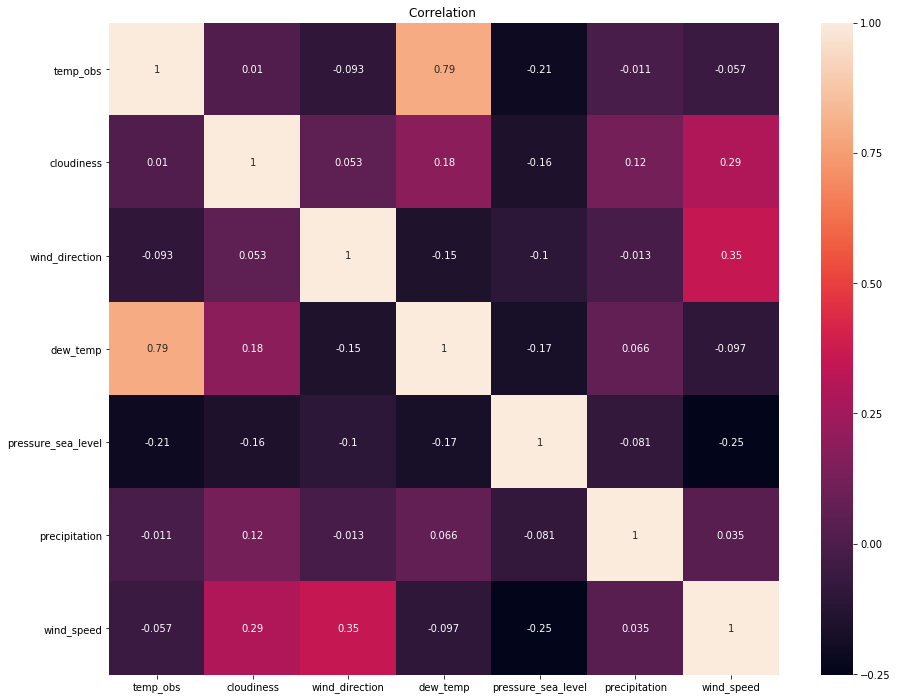

In [74]:
import seaborn as sns
import matplotlib.pyplot as plt
corr=weather_merge.corr()
fig = plt.figure(figsize=(15,12))
r = sns.heatmap(corr,annot=True)
r.set_title("Correlation ")

In [80]:
pd.read_csv(('/content/drive/My Drive/Sudheer Projects/phd/weather_data_location_wise/'+'location 4525'+'.csv'),index_col=0)['cloudiness'].isna().value_counts().index.values

array([True], dtype=object)

In [129]:
def inspect_data(data) :
      return pd.DataFrame({"Data type": data.dtypes,"NUll Values": data.isnull().sum(),
                           "No of Levels": data.apply(lambda x: str(x.nunique()),axis=0),
                          "Levels": data.apply(lambda x: str(x.unique()),axis=0)})
inspect_data(pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/weather_data_imputations/location 4525.csv'))

,Data type,NUll Values,No of Levels,Levels
deidentified_location,object,0,1,['location 4525']
temp_obs,float64,0,705,[-1.8 -1.7 -2.7 -2.3 -2.6 -2.2 -2.8 -3.0 -3.3 ...
cloudiness,float64,8784,0,[nan]
wind_direction,float64,0,140,[280.0 260.0 350.0 310.0 270.0 230.0 200.0 190...
dew_temp,float64,0,636,[-3.2 -2.8 -3.3 -3.6 -3.8 -4.0 -3.4 -2.9 -2.7 ...
pressure_sea_level,float64,0,613,[1016.0 1016.1 1015.8 1015.4 1015.1 1014.7 101...
precipitation,float64,0,5601,[5.0 3.5 2.0 ... 2.9354838709677415 2.96774193...
wind_speed,float64,0,147,[1.5 1.0 0.5 2.1 3.1 3.6 5.7 4.6 5.1 4.1 6.2 2...


In [0]:
weather_imputation_full=pd.DataFrame()
for location in weather_merge.deidentified_location.unique():
  temp_dataframe=pd.read_csv(('/content/drive/My Drive/Sudheer Projects/phd/weather_data_imputations/'+location+'.csv'))
  if location==weather_merge.deidentified_location.unique()[0]:
    weather_imputation_full=temp_dataframe
  else:
    weather_imputation_full=weather_imputation_full.append(temp_dataframe,ignore_index=True)

In [154]:
weather_imputation_full

,timestamp,deidentified_location,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
0,2016-01-01 00:00:00,location 1784,-10.6,0.0,0.0,-13.9,1036.7,0.0,0.0
1,2016-01-01 01:00:00,location 1784,-10.6,0.0,0.0,-13.9,1036.7,0.0,0.0
2,2016-01-01 02:00:00,location 1784,-11.1,0.0,0.0,-13.9,1036.9,0.0,0.0
3,2016-01-01 03:00:00,location 1784,-10.0,0.0,280.0,-15.0,1036.9,0.0,2.6
4,2016-01-01 04:00:00,location 1784,-13.3,0.0,230.0,-15.6,1037.8,0.0,1.5
...,...,...,...,...,...,...,...,...,...
140539,2016-12-31 19:00:00,location 959,8.1,9.0,220.0,6.5,1027.5,NaN,3.6
140540,2016-12-31 20:00:00,location 959,7.2,9.0,220.0,6.1,1026.9,NaN,4.1
140541,2016-12-31 21:00:00,location 959,6.9,9.0,220.0,5.8,1026.2,NaN,4.6
140542,2016-12-31 22:00:00,location 959,6.9,9.0,190.0,6.2,1025.4,NaN,3.1


In [0]:
weather_imputation_full.to_csv('/content/drive/My Drive/Sudheer Projects/phd/temp_imputations_weather.csv',index=False)

In [160]:
inspect_data(weather_imputation_full)

,Data type,NUll Values,No of Levels,Levels
timestamp,object,0,8784,['2016-01-01 00:00:00' '2016-01-01 01:00:00' '...
deidentified_location,object,0,16,['location 1784' 'location 2532' 'location 452...
temp_obs,float64,0,1012,[-10.6 -11.1 -10.0 ... 16.45 6.433333333333334...
cloudiness,float64,17568,3908,[0.0 1.0 2.0 ... 0.22881355932203284 0.1525423...
wind_direction,float64,0,686,[0.0 280.0 230.0 310.0 340.0 240.0 300.0 40.0 ...
dew_temp,float64,0,919,[-13.9 -15.0 -15.6 -17.2 -16.7 -17.8 -18.3 -18...
pressure_sea_level,float64,8784,1650,[1036.7 1036.9 1037.8 ... 1044.8 1043.9 1043.4]
precipitation,float64,26352,8867,[0.0 -1.0 3.0 ... -0.008474576271186418 nan 78.0]
wind_speed,float64,0,343,[0.0 2.6 1.5 4.1 3.1 3.6 4.6 2.1 5.1 5.7 7.2 6...


In [162]:
weather_imputation_full.columns

Index(['timestamp', 'deidentified_location', 'temp_obs', 'cloudiness',
       'wind_direction', 'dew_temp', 'pressure_sea_level', 'precipitation',
       'wind_speed'],
      dtype='object')

In [0]:
for column in ['temp_obs', 'cloudiness','wind_direction', 'dew_temp', 'pressure_sea_level', 'precipitation','wind_speed']:
  weather_imputation_full[column].fillna(weather_imputation_full[column].median(),inplace=True)

In [167]:
inspect_data(weather_imputation_full)

,Data type,NUll Values,No of Levels,Levels
timestamp,object,0,8784,['2016-01-01 00:00:00' '2016-01-01 01:00:00' '...
deidentified_location,object,0,16,['location 1784' 'location 2532' 'location 452...
temp_obs,float64,0,1012,[-10.6 -11.1 -10.0 ... 16.45 6.433333333333334...
cloudiness,float64,0,3908,[0.0 1.0 2.0 ... 0.22881355932203284 0.1525423...
wind_direction,float64,0,686,[0.0 280.0 230.0 310.0 340.0 240.0 300.0 40.0 ...
dew_temp,float64,0,919,[-13.9 -15.0 -15.6 -17.2 -16.7 -17.8 -18.3 -18...
pressure_sea_level,float64,0,1650,[1036.7 1036.9 1037.8 ... 1044.8 1043.9 1043.4]
precipitation,float64,0,8867,[0.0 -1.0 3.0 ... -0.016949152542372836 -0.008...
wind_speed,float64,0,343,[0.0 2.6 1.5 4.1 3.1 3.6 4.6 2.1 5.1 5.7 7.2 6...


In [0]:
weather_imputation_full.to_csv('/content/drive/My Drive/Sudheer Projects/phd/train_imputation_weather.csv',index=False)

In [0]:
train_data_master=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/train_data.csv')

In [174]:
train_data_master.columns

Index(['date', 'farm_id', 'ingredient_type', 'yield'], dtype='object')

In [0]:
final_train=train_data_master.groupby(by=['date', 'farm_id', 'ingredient_type'],as_index=False).sum()

In [0]:
final_train.to_csv('/content/drive/My Drive/Sudheer Projects/phd/train_data_yeild_sum_grouby.csv')

In [181]:
final_train.dtypes

date                object
farm_id             object
ingredient_type     object
yield              float64
dtype: object

In [182]:
weather_imputation_full.dtypes

timestamp                 object
deidentified_location     object
temp_obs                 float64
cloudiness               float64
wind_direction           float64
dew_temp                 float64
pressure_sea_level       float64
precipitation            float64
wind_speed               float64
dtype: object

In [7]:
farm_data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/new_farm_data.csv',index_col=0)
final_train=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/train_data_yeild_sum_grouby.csv',index_col=0)
weather_imputation_full=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/train_imputation_weather.csv')

/usr/local/lib/python3.6/dist-packages/numpy/lib/arraysetops.py:568: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [0]:
weather_imputation_full.timestamp=weather_imputation_full.timestamp.astype('datetime64[ns]')

In [0]:
final_train.rename(columns={'date':'timestamp'},inplace=True)

In [0]:
final_train.timestamp=final_train.timestamp.astype('datetime64[ns]')

In [0]:
farmdata_traindata=pd.merge(final_train, farm_data, on=['farm_id'], how='left')

In [0]:
final_merge=pd.merge(farmdata_traindata, weather_imputation_full, on=['timestamp', 'deidentified_location'], how='inner')

In [0]:
final_merge.drop(['operations_commencing_year','num_processing_plants'],inplace=True,axis=1)

In [0]:
final_merge.to_csv('/content/drive/My Drive/Sudheer Projects/phd/No_Null_final_train_merge.csv',index=False) 

In [18]:
final_merge

timestamp                datetime64[ns]
farm_id                          object
ingredient_type                  object
yield                           float64
farm_area                       float64
farming_company                  object
deidentified_location            object
temp_obs                        float64
cloudiness                      float64
wind_direction                  float64
dew_temp                        float64
pressure_sea_level              float64
precipitation                   float64
wind_speed                      float64
dtype: object

In [0]:
final_merge=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/No_Null_final_train_merge.csv') 

In [6]:
final_merge.dtypes

timestamp                 object
farm_id                   object
ingredient_type           object
yield                    float64
farm_area                float64
farming_company           object
deidentified_location     object
temp_obs                 float64
cloudiness               float64
wind_direction           float64
dew_temp                 float64
pressure_sea_level       float64
precipitation            float64
wind_speed               float64
dtype: object

In [0]:
final_merge['month']=pd.DatetimeIndex(final_merge['timestamp']).month
final_merge['day']=pd.DatetimeIndex(final_merge['timestamp']).day
final_merge['hour']=pd.DatetimeIndex(final_merge['timestamp']).hour
final_merge['weekday']=pd.DatetimeIndex(final_merge['timestamp']).weekday
final_merge['quarter']=pd.DatetimeIndex(final_merge['timestamp']).quarter
final_merge['weekofyear']=pd.DatetimeIndex(final_merge['timestamp']).weekofyear

In [0]:
a=np.array(final_merge['yield'])
from scipy import stats
yield_zsocres=stats.zscore(a)
final_merge['z_scores']=pd.Series(yield_zsocres)

In [0]:
target_encoding=final_merge.groupby(by=['timestamp','ingredient_type'],as_index=False).sum().sort_values(by=['ingredient_type','timestamp'])[['timestamp','ingredient_type','yield']]

In [38]:
366*24*4

35136

In [7]:
a=np.array(target_encoding['yield'])
from scipy import stats
yield_zsocres=stats.zscore(a)
target_encoding['z_scores']=pd.Series(yield_zsocres)
target_encoding

,timestamp,ingredient_type,yield,z_scores
0,2016-01-01 00:00:00,ing_w,146796.9708,-0.298947
4,2016-01-01 01:00:00,ing_w,166439.5826,-0.293203
8,2016-01-01 02:00:00,ing_w,166652.5184,-0.289135
12,2016-01-01 03:00:00,ing_w,166988.5308,-0.289140
16,2016-01-01 04:00:00,ing_w,167381.4970,-0.288977
...,...,...,...,...
35119,2016-12-31 19:00:00,ing_z,61047.5909,-0.303376
35123,2016-12-31 20:00:00,ing_z,57128.0834,-0.316273
35127,2016-12-31 21:00:00,ing_z,121392.9498,-0.317354
35131,2016-12-31 22:00:00,ing_z,110531.4658,-0.322875


In [54]:
import altair as alt
alt.data_transformers.disable_max_rows()
chart2=alt.Chart(target_encoding[target_encoding.ingredient_type=='ing_y']).mark_rect().encode(
    alt.Y('hoursminutes(timestamp):O', title='hour of day',sort='-x'),
    alt.X('monthdate(timestamp):O', title='date'),
    alt.Color('yield:Q', title='yield')
)
chart2


alt.Chart(...)

In [67]:
import altair as alt
alt.data_transformers.disable_max_rows()
chart=alt.Chart(target_encoding[target_encoding.ingredient_type=='ing_z']).mark_bar().encode(
    alt.Y('yield:Q', title='yield'),
    alt.X('monthdate(timestamp):O', title='date'),
    tooltip=['monthdate(timestamp)','yield','ingredient_type']
)
chart

alt.Chart(...)

In [74]:
final_merge[final_merge['yield']==0][final_merge['ingredient_type']=='ing_y'].shape

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


(346960, 21)

In [8]:
target_encoding

,timestamp,ingredient_type,yield,z_scores
0,2016-01-01 00:00:00,ing_w,146796.9708,-0.298947
4,2016-01-01 01:00:00,ing_w,166439.5826,-0.293203
8,2016-01-01 02:00:00,ing_w,166652.5184,-0.289135
12,2016-01-01 03:00:00,ing_w,166988.5308,-0.289140
16,2016-01-01 04:00:00,ing_w,167381.4970,-0.288977
...,...,...,...,...
35119,2016-12-31 19:00:00,ing_z,61047.5909,-0.303376
35123,2016-12-31 20:00:00,ing_z,57128.0834,-0.316273
35127,2016-12-31 21:00:00,ing_z,121392.9498,-0.317354
35131,2016-12-31 22:00:00,ing_z,110531.4658,-0.322875


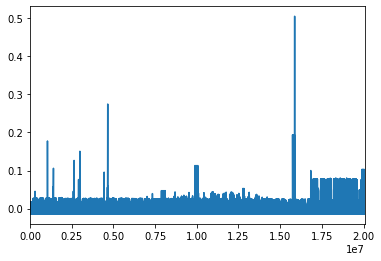

In [55]:
final_merge['z_scores'][final_merge['ingredient_type']=='ing_w'].plot(x='z_scores',y='yield')

In [53]:
final_merge[final_merge['ingredient_type']=='ing_w'][final_merge['z_scores']<-0.006367752957625422][['z_scores','yield']].describe()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,z_scores,yield
count,1.170050e+07,1.170050e+07
mean,-1.300073e-02,1.325265e+02
std,1.207557e-03,1.856642e+02
min,-1.386268e-02,0.000000e+00
25%,-1.373748e-02,1.925000e+01
50%,-1.346265e-02,6.150540e+01
75%,-1.281012e-02,1.618330e+02
max,-6.367883e-03,1.152340e+03


In [58]:
np.percentile(final_merge[final_merge['ingredient_type']=='ing_w'][['z_scores']],97)

-0.007840560621414795

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


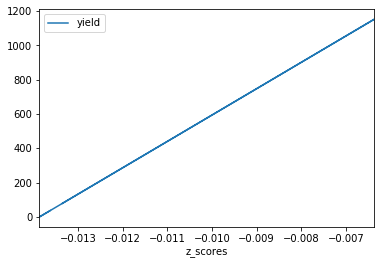

In [57]:
final_merge[final_merge['ingredient_type']=='ing_w'][final_merge['z_scores']<-0.006367752957625422].plot(x='z_scores',y='yield')

In [47]:
final_merge.shape

(20080532, 21)

In [48]:
20080532-18320700

1759832

In [52]:
20080532-18673646

1406886

In [0]:
final_merge[final_merge['z_scores']<-0.006367752957625422].to_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/outliers_removed_97percentile_raw.csv',index=False)

In [0]:
farm_id_targetencoding=final_merge[final_merge['z_scores']<-0.006367752957625422].drop(['timestamp','z_scores'],axis=1).groupby(['farm_id',"ingredient_type"],as_index=False).sum()[['farm_id','ingredient_type','yield']]

In [80]:
farm_id_targetencoding

,farm_id,ingredient_type,yield
0,fid_100053,ing_w,4.722934e+05
1,fid_100107,ing_w,3.815404e+06
2,fid_100107,ing_x,2.158531e+06
3,fid_100107,ing_y,4.056406e+05
4,fid_100135,ing_w,2.196656e+05
...,...,...,...
2357,fid_99921,ing_w,1.285013e+06
2358,fid_99921,ing_x,2.144410e+06
2359,fid_99942,ing_w,1.313502e+06
2360,fid_99942,ing_x,2.571440e+06


In [0]:
temp=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/file_paths.csv')

In [0]:
temp=pd.merge(temp,farm_id_targetencoding,how='left')

In [78]:
temp.dtypes

file_paths          object
farm_id             object
ingredient_type     object
yeild_nan_count      int64
yield              float64
dtype: object

In [0]:
temp.rename(columns={'yeild_nan_count':'timeseries_data_weightage'},inplace=True)
temp.rename(columns={'yield':'farm_id_target_encoding'},inplace=True)

In [0]:
temp.fillna(0,inplace=True)

In [0]:
temp.rename(columns={'yield':'farm_id_ingredient_target_encoding_weightage'},inplace=True)

In [0]:
temp.to_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/basic_farm_id_target_encoding.csv',index=False)

In [0]:
raw_train_data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/outliers_removed_97percentile_raw.csv')

In [9]:
raw_train_data.dtypes

timestamp                 object
farm_id                   object
ingredient_type           object
yield                    float64
farm_area                float64
farming_company           object
deidentified_location     object
temp_obs                 float64
cloudiness               float64
wind_direction           float64
dew_temp                 float64
pressure_sea_level       float64
precipitation            float64
wind_speed               float64
month                      int64
day                        int64
hour                       int64
weekday                    int64
quarter                    int64
weekofyear                 int64
z_scores                 float64
dtype: object

In [0]:
global_ingredient_timeseries=raw_train_data.groupby(['ingredient_type','timestamp'],as_index=False).sum()[['ingredient_type','timestamp','yield']]

In [11]:
global_ingredient_timeseries[global_ingredient_timeseries.ingredient_type=='ing_w'].

35136

In [17]:
chart=alt.Chart(global_ingredient_timeseries).mark_line().encode(
    alt.Y('yield:Q', title='yield'),
    alt.X('monthdate(timestamp):O', title='date'),
    tooltip=['monthdate(timestamp)','yield','ingredient_type'],
    color='ingredient_type'
)
chart

alt.Chart(...)

In [0]:
global_ingredient_timeseries.rename(columns={'yield':'time_series_yield_target_encoding'},inplace=True)

In [0]:
global_ingredient_timeseries.to_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/global_ingredient_timeseries.csv',index=False)

In [35]:
global_ingredient_timeseries

,ingredient_type,timestamp,time_series_yield_target_encoding
0,ing_w,2016-01-01 00:00:00,117865.7408
1,ing_w,2016-01-01 01:00:00,137584.2926
2,ing_w,2016-01-01 02:00:00,137688.7884
3,ing_w,2016-01-01 03:00:00,137912.4408
4,ing_w,2016-01-01 04:00:00,138252.1670
...,...,...,...
35131,ing_z,2016-12-31 19:00:00,24332.0309
35132,ing_z,2016-12-31 20:00:00,24467.9034
35133,ing_z,2016-12-31 21:00:00,21907.7998
35134,ing_z,2016-12-31 22:00:00,23170.3658


In [0]:
farm_id_target_encoding=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/basic_farm_id_target_encoding.csv')

In [40]:
farm_id_target_encoding

,file_paths,farm_id,ingredient_type,timeseries_data_weightage,farm_id_target_encoding,farm_id_ingredient_target_encoding_weightage
0,E:\phd\by_farm_id_and_ingredient_type\fid_1108...,fid_110884,ing_w,0,1.286461e+06,1.286461e+06
1,E:\phd\by_farm_id_and_ingredient_type\fid_1108...,fid_110884,ing_z,8784,1.286461e+06,0.000000e+00
2,E:\phd\by_farm_id_and_ingredient_type\fid_1108...,fid_110884,ing_x,8784,1.286461e+06,0.000000e+00
3,E:\phd\by_farm_id_and_ingredient_type\fid_1108...,fid_110884,ing_y,8784,1.286461e+06,0.000000e+00
4,E:\phd\by_farm_id_and_ingredient_type\fid_9005...,fid_90053,ing_w,0,6.576176e+05,6.576176e+05
...,...,...,...,...,...,...
5731,E:\phd\by_farm_id_and_ingredient_type\fid_6065...,fid_60652,ing_y,6127,3.965962e+04,3.965962e+04
5732,E:\phd\by_farm_id_and_ingredient_type\fid_1986...,fid_19864,ing_w,8305,2.422705e+04,2.422705e+04
5733,E:\phd\by_farm_id_and_ingredient_type\fid_1986...,fid_19864,ing_z,8784,2.422705e+04,0.000000e+00
5734,E:\phd\by_farm_id_and_ingredient_type\fid_1986...,fid_19864,ing_x,8784,2.422705e+04,0.000000e+00


In [0]:
Training_data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/outliers_removed_97percentile_raw.csv')

In [37]:
Training_data.shape

(18673646, 21)

In [0]:
Training_data=pd.merge(Training_data,global_ingredient_timeseries,how='left',on=['ingredient_type','timestamp'])

In [0]:
Training_data=pd.merge(Training_data,farm_id_target_encoding,how='left',on=['farm_id','ingredient_type'])

In [42]:
Training_data.shape

(18673646, 26)

In [43]:
Training_data.dtypes

timestamp                                        object
farm_id                                          object
ingredient_type                                  object
yield                                           float64
farm_area                                       float64
farming_company                                  object
deidentified_location                            object
temp_obs                                        float64
cloudiness                                      float64
wind_direction                                  float64
dew_temp                                        float64
pressure_sea_level                              float64
precipitation                                   float64
wind_speed                                      float64
month                                             int64
day                                               int64
hour                                              int64
weekday                                         

In [0]:
Training_data.drop(['timestamp','farm_id','z_scores'],inplace=True,axis=1)


In [0]:
Training_data.drop(['file_paths'],inplace=True,axis=1)

In [50]:
Training_data.dtypes

ingredient_type                                  object
yield                                           float64
farm_area                                       float64
farming_company                                  object
deidentified_location                            object
temp_obs                                        float64
cloudiness                                      float64
wind_direction                                  float64
dew_temp                                        float64
pressure_sea_level                              float64
precipitation                                   float64
wind_speed                                      float64
month                                             int64
day                                               int64
hour                                              int64
weekday                                           int64
quarter                                           int64
weekofyear                                      

In [0]:
Training_data.to_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/model_training_data.csv')

In [0]:
cat_cols=['ingredient_type','weekofyear','quarter','weekday','hour','day','month','farming_company','deidentified_location']

In [0]:
Training_data[cat_cols] = Training_data[cat_cols].astype("category")
Training_data.to_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/model_training_data.csv')

In [54]:
Training_data.dtypes

ingredient_type                                 category
yield                                            float64
farm_area                                        float64
farming_company                                 category
deidentified_location                           category
temp_obs                                         float64
cloudiness                                       float64
wind_direction                                   float64
dew_temp                                         float64
pressure_sea_level                               float64
precipitation                                    float64
wind_speed                                       float64
month                                           category
day                                             category
hour                                            category
weekday                                         category
quarter                                         category
weekofyear                     

In [4]:
Training_data=pd.read_csv('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/model_training_data.csv',index_col=0)

/usr/local/lib/python3.6/dist-packages/numpy/lib/arraysetops.py:568: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [5]:
import pickle 
pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/Train_data.sav","wb")
pickle.dump(Training_data, pickle_out)
pickle_out.close()
print("random_forest object saved")

random_forest object saved


In [0]:

from sklearn.preprocessing import LabelEncoder
label_encoder=LabelEncoder()
le_ingredient_type=label_encoder.fit(Training_data['ingredient_type'])
Training_data['ingredient_type']=le_ingredient_type.transform(Training_data['ingredient_type'])
import pickle
pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/le_ingredient_type.pickle","wb")
pickle.dump(le_ingredient_type, pickle_out)
pickle_out.close()


In [0]:
label_encoder=LabelEncoder()
le_deidentified_location=label_encoder.fit(Training_data['deidentified_location'])
Training_data['deidentified_location']=le_deidentified_location.transform(Training_data['deidentified_location'])

pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/le_deidentified_location.pickle","wb")
pickle.dump(le_deidentified_location, pickle_out)
pickle_out.close()


In [0]:
label_encoder=LabelEncoder()
le_farming_company=label_encoder.fit(Training_data['farming_company'])
Training_data['farming_company']=le_farming_company.transform(Training_data['farming_company'])

pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/le_farming_company.pickle","wb")
pickle.dump(le_farming_company, pickle_out)
pickle_out.close()


In [10]:
import pickle 
pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/Train_data.sav","wb")
pickle.dump(Training_data, pickle_out)
pickle_out.close()
print("Train data pickled")

Train data pickled


In [11]:
Training_data


,ingredient_type,yield,farm_area,farming_company,deidentified_location,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,month,day,hour,weekday,quarter,weekofyear,time_series_yield_target_encoding,timeseries_data_weightage,farm_id_target_encoding,farm_id_ingredient_target_encoding_weightage
0,0,37.040,2043.866000,0,4,10.0,8.0,350.0,2.2,1021.1,0.0,4.1,1,1,0,4,1,53,117865.7408,346,4.722934e+05,4.722934e+05
1,0,15.640,1432.564260,1,4,10.0,8.0,350.0,2.2,1021.1,0.0,4.1,1,1,0,4,1,53,117865.7408,3,2.196656e+05,2.196656e+05
2,0,32.760,3716.120000,14,4,10.0,8.0,350.0,2.2,1021.1,0.0,4.1,1,1,0,4,1,53,117865.7408,2,5.318755e+05,5.318755e+05
3,0,10.600,2712.024376,2,4,10.0,8.0,350.0,2.2,1021.1,0.0,4.1,1,1,0,4,1,53,117865.7408,2,4.039565e+05,4.039565e+05
4,0,32.560,13378.032000,0,4,10.0,8.0,350.0,2.2,1021.1,0.0,4.1,1,1,0,4,1,53,117865.7408,2,5.011941e+05,5.011941e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18673641,1,0.000,8659.117018,8,14,-9.6,2.0,70.0,-10.8,1004.7,5.0,4.1,12,31,23,5,4,52,52442.6647,92,4.126683e+06,6.736485e+05
18673642,3,169.250,8659.117018,8,14,-9.6,2.0,70.0,-10.8,1004.7,5.0,4.1,12,31,23,5,4,52,21276.0349,91,4.126683e+06,7.971745e+05
18673643,0,78.625,7561.375170,8,14,-9.6,2.0,70.0,-10.8,1004.7,5.0,4.1,12,31,23,5,4,52,159697.0412,323,3.143091e+06,1.918838e+06
18673644,1,0.000,7561.375170,8,14,-9.6,2.0,70.0,-10.8,1004.7,5.0,4.1,12,31,23,5,4,52,52442.6647,2293,3.143091e+06,6.472013e+05


In [60]:
pickle_in = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/dict.pickle","rb")
example_dict = pickle.load(pickle_in)

{1: '6', 2: '2', 3: 'f'}

In [15]:
import time
start = time.time()

x=Training_data.copy().drop('yield',axis=1)
y=Training_data['yield']


from sklearn import model_selection

X_train,X_test,Y_train,Y_test=model_selection.train_test_split(x,y,test_size=0.3,random_state=4)


from sklearn.tree import DecisionTreeRegressor
params={'max_depth': 5, 'min_samples_leaf': 100, 'min_samples_split': 6}
regressor = DecisionTreeRegressor(**params)
decision_tree_model=regressor.fit(X_train, Y_train)

Y_pred_train = decision_tree_model.predict(X_train)
Y_pred_test=decision_tree_model.predict(X_test)
from sklearn.metrics import mean_squared_error
mse_train=mean_squared_error(Y_train,Y_pred_train)
mse_test=mean_squared_error(Y_test,Y_pred_test)

import numpy as np 
rmse_test=np.sqrt(mse_test)
rmse_train=np.sqrt(mse_train)
print("Train RMSE")
print(np.sqrt(mse_train))
print("Test RMSE")
print(np.sqrt(mse_test))

done = time.time()
elapsed = done - start
print(elapsed)




Train RMSE
139.32853518357183
Test RMSE
139.2184575798656
126.69276976585388


In [0]:
pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/decision_tree_model.pickle","wb")
pickle.dump(decision_tree_model, pickle_out)
pickle_out.close()


In [0]:
import pandas as pd
import numpy as np
Training_data=pd.read_pickle('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/Train_data.sav')
import time
start = time.time()

x=Training_data.copy().drop('yield',axis=1)
y=Training_data['yield']


from sklearn import model_selection
from sklearn.ensemble import RandomForestRegressor

X_train,X_test,Y_train,Y_test=model_selection.train_test_split(x,y,test_size=0.3,random_state=4)
print("Train validation split successful")

regressor = RandomForestRegressor(n_jobs=-1)
random_forest_tree_model=regressor.fit(X_train, Y_train)

print("Model fit complete")

pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/random_forest_tree_model.pickle","wb")
pickle.dump(random_forest_tree_model, pickle_out)
pickle_out.close()
print("random_forest object saved")

Y_pred_train = random_forest_tree_model.predict(X_train)
Y_pred_test=random_forest_tree_model.predict(X_test)

from sklearn.metrics import mean_squared_error
mse_train=mean_squared_error(Y_train,Y_pred_train)
mse_test=mean_squared_error(Y_test,Y_pred_test)

import numpy as np 
rmse_test=np.sqrt(mse_test)
rmse_train=np.sqrt(mse_train)
print("Train RMSE")
print(np.sqrt(mse_train))
print("Test RMSE")
print(np.sqrt(mse_test))

done = time.time()
elapsed = done - start
print(elapsed)



Train validation split successful


/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


In [0]:
pickle_out = open("/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/random_forest_tree_model.pickle","wb")
pickle.dump(random_forest_tree_model, pickle_out)
pickle_out.close()
print("random_forest object saved")


In [0]:
import pandas as pd
import pickle
pickle_in = open('/content/drive/My Drive/Sudheer Projects/phd/Model_building_dataSets/decision_tree_model.pickle',"rb")
random_forest_tree_model= pickle.load(pickle_in)

In [4]:
 random_forest_tree_model

DecisionTreeRegressor(criterion='mse', max_depth=5, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=100,
                      min_samples_split=6, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')